<h1 class="heading"> Montecarlo Simulation</h1>
<h1>Tools presentation and workflow example</h1>

<h6 class="author"> — <b style="color:rgb(0,51,102);">Carmine Varriale, Agostino De Marco</b>, <i>University of Naples Federico II</i></h6>

## Introduction
<div class="main">
In this Notebook, we are doing an in-depth presentation of the typical workflow required to setup, launch and analyze a Montecarlo simulation with JSBSim. All of the simulations will be generated randomly from a preset JSBSim script, and run automatically. <br><br>

In the script, we are using everything we have developed up to now, that is we are again implementing the waypoint based navigation paradigm, and this time we are enforcing it with glide angle and speed control all along the trajectory. To test the navigation algorithms more thoroughly, we are now attempting to approach the North East end of the Capodichino airport in Naples, Italy. As we did for the test case, we are going to input coordinates for a navigation waypoint on the field starting point; in addition, this time we are also defining the orientation of the landing field as an input parameter: these two variables will constitute a fundamental reference throughout all the different phases of the simulation.<br><br>

In order to carry out our calculations, we are using a slightly different setup this time; it is based on the Python classes <div class="typewr">SimFamily</div> and <div class="typewr">PostGroup</div>, which have been expressly conceived for managing Montecarlo simulations starting from a template script. Therefore, here is our new setup:
</div>

In [1]:
% run ./python/nb_init.py                        
% matplotlib inline

import geography as geo
import data_handling as dh
from property_map import pmap
from MCSim import SimFamily, PostGroup, PostData

Let's now take a few moments to briefly illustrate some of the methods and attributes that may be useful to the user.

## 1. The SimFamily class utilities

The <span class="typewr">SimFamily</span> class is conceived to manage data from the initialization stage to the simulation one. <br>
It relies on other, _under-the-hood_, classes devolved to easily handle directories paths, <span class="typewr">.xml</span> files and the tree structures defined in them: these are totally different wheter we are dealing with a JSBSim initialization file, with a script or with the aircraft configuration file. <br><br>

In order to create an instance of the class, the number of simulations must be indicated together with the template script file, the autopilot file and the main output folder that will contain all the data produced during the process. Two Python empty dictionaries are initialized, namely
<span class="typewr">mc_stack</span> and <span class="typewr">value_stack</span>.
Their purpose is to store user input data (via Notebook) so that it can be easily referenced for launching different parallel simulations. Furthermore, an empty variable named <span class="typewr">test_property</span> (of type <span class="typewr">None</span>) is created. This will serve the purpose of testing different values of a same JSBSim properties for studying trends of the trajectory: the most typical case is the tuning procedure of several collaborating autopilot systems.

In [2]:
N = 50
script     = 'c172x_MCSim_Presentation'
autopilot  = 'c172ap_unina'
output_fol = 'MCSim_Presentation'

# Creating instance of the class
Sim1 = SimFamily(N, seed_name      = script,
                    autopilot_name = autopilot,
                    out_foldername = output_fol)

### 1.1. Inserting data for JSBSim Montecarlo simulations
There are three types of data we are going to input for a JSBSim Montecarlo simulation:
<ol>
<li>
**Fixed data**, which must remain the same across all the Montecarlo simulations, is input by the user through a class method called <span class="typewr">set_value()</span>. It's syntax is really simple and hopefully self-explainatory: 

<div class="path">
    set_value(<span class="varstr">'JSBSim_property_name'</span>, <span class="varnum">value</span>)
</div>

This will create an entry in the <span class="typewr">value_stack</span> dictionary in the form of:

<div class="path">value_stack = {<span class="varstr">'JSBSim_property_name'</span>: <span class="varnum">[value]</span>}</div>
Note that the dictionary value is a single element list.
</li>



<li>
**Random data**, which is different for each simulation in the family, is input and controlled by the user through a class method called <span class="typewr">generate_series()</span>. It's syntax is indicated here:

<div class="path">generate_series(<span class="varstr">'JSBSim_property_name'</span>, <span class="varstr">'probability_distribution'</span>, (<span class="varnum">param_1</span>, <span class="varnum">param_2</span>))</div>

where <span class="typewr"><span class="varstr">'probability_distribution'</span></span> may be either <span class="typewr"><span class="varstr">'uniform'</span></span> or <span class="typewr"><span class="varstr">'gaussian'</span></span>. In the former case, the two parameters are the inferior and superior bounds for inserted data, whereas in the latter case they are the mean and standard deviation of the normal distribution.<br>
Such a statement will create an entry in the <span class="typewr">mc_stack</span> dictionary in the form of:

<div class="path">mc_stack = {<span class="varstr">'JSBSim_property_name'</span>: [<span class="varnum">value_1</span>, <span class="varnum">value_2</span>, ..., <span class="varnum">value_N</span>]}</div>
where the list of values corresponding to the property contains as many elements as the number of simulations required at initialization time.
</li>



<li>
**Test data**, for only one property at a time, which changes across the simulations but in a controlled way. It is input by the user through a class method called <span class="typewr">set_test_property()</span>, and whose syntax is reported here:

<div class="path">set_test_property(<span class="varstr">'xml_address_of_property'</span>, (<span class="varnum">min</span>, <span class="varnum">max</span>))</div>

The <span class="varstr">'xml_address_of_property'</span> parameter is an XPath-type string (check the <a href="http://www.w3schools.com/xml/xpath_intro.asp">W3CSchools tutorial</a> or <a href="http://effbot.org/zone/element-xpath.htm">here</a> for the Python package tutorial to supported syntax). What the method does is simply create a Python list, linearly ranging from <span class="varnum">min</span> to <span class="varnum">max</span>, and assign its values to the respective simulation.


</li>
</ol>
<br>

<div class="main">
Note that all of the methods return the created variables as function ouput, so that they can be stored in inline Python variables and easily managed outside the class object, too. Also, pay attention to the fact that JSBSim property names may vary in a very significant way depending on the file they belong to: so, if we wanted to define a value for updating the initialization file, we would write something like, for example,

<div class="path">
 set_value(<span class="varstr">'altitude'</span>, <span class="varnum">1200</span>)
</div>

whereas if we wanted to update a property for the script file we would have to write something like

<div class="path">
 set_value(<span class="varstr">'guidance/target-field-wp-latitude-rad'</span>, <span class="varnum">0.713689373764</span>)
</div>
</div>


### 1.2. Launching JSBSim simulations
The <span class="typewr">SimFamily</span> class provides one method to perform multi-threading simulations in a completely automatic way. If the setup has been carried out correctly, the function will take care of everything and optionally provide some logging information about threads status and time consumption of the process.<br><br>

This core method is called <span class="typewr">launch_mc_sim()</span> and performs the following series of operations:
1. Creates a main output directory, generates the catalog and a <span class="typewr">.csv</span> file version of the <span class="typewr">mc_stack</span> and <span class="typewr">value_stack</span> dictionaries, and moves them there.
2. Accesses the template script and initialization files xml tree to update all the properties in the <span class="typewr">value_stack</span> dictionary. These are the fixed parameters, so they will be the same for all the simulations.
3. For every requested simulation, starts a thread in which it:
    1. Creates a parallel aircraft folder, to whose name is appended a label corresponding to an incresing index.
    2. Copies the aircraft configuration file, template initialization file and autopilot file to the folder in step A, and labels them in a similar fashion. In the copied configuration file, <span class="typewr">output</span> tags are updated with the same label as step A to avoid conflicts during multi-threading calculations;
    3. The template script file is copied in its same folder, with the copy's name labelled likewise; in the copied script, <span class="typewr">aircraft</span> and <span class="typewr">initialize</span> attributes of the <span class="typewr">use</span> tag are updated to refer to the ones in the newly created aircraft configuration folder (step A)
    4. Random properties are updated, each with the value from the <span class="typewr">mc_stack</span> dictionary corresponding to their label.
    5. Simulation is run in a separate thread from all the other ones.
    6. JSBSim output and log files are moved to a subfolder of the output directory, and the temporary copies of the aircraft configuration files and folder are deleted.
    
### 1.3. Extracting a group of simulations for post-processing
Once calculation is complete, the <span class="typewr">SimFamily</span> class gives the possibility to post process the whole set of output data folders or just a selected group from it. This is done easily with a call to the method

<div class="path">
 extract_post_group([<span class="varnum">index_1</span>, <span class="varnum">index_2</span>, ..., <span class="varnum">index_N</span>], <span class="varstr">group_label</span>)
</div>

which, in turn, creates an instance of the class <span class="typewr">PostGroup</span>, that will be be presented later in the Notebook.

## 2. Simulation setup

As it should be clear by now, the simulation set-up requires perfect harmony between Notebook data and JSBSim scripted sequence of events. In order to avoid running up into unpleasant mistakes, it is important to set things clear from the beginning. In this Notebook, we are keeping in mind the following scheme, with the field waypoint being the origin of a NED reference frame, for synchronizing data and operations:

![Simulation scheme](./images/WP-NED-scheme-500.png)

### 2.1 Notebook side setup
After creating an instance of the class, the first and most important thing to do is assign coordinates of the Field Waypoint ($\mathrm{WPF}$ in the scheme) in terms of latitude and longitude. These can be easily acquired via free internet utilities such as Google Maps or Google Earth.

In [3]:
# Field waypoint coordinates
WPf_lat_deg  = 40.891389
WPf_lon_deg  = 14.302145
WPf_lat_rad  = Sim1.set_value('guidance/target-field-wp-latitude-rad',  np.radians(WPf_lat_deg))
WPf_lon_rad  = Sim1.set_value('guidance/target-field-wp-longitude-rad', np.radians(WPf_lon_deg))

The second and third essential parameters to be input correctly are the orientation of the field, in the actual direction we are landing on it, and the distance of the alignment waypoint ($\mathrm{WP1}$ in the scheme) from the field waypoint. The exact position of $\mathrm{WP1}$ will be calculated automatically in terms of latitude and longitude, given these two parameters: it is of crucial importance for performing good alignment and a correct landing.

In [4]:
# Field orientation
field_or_deg = Sim1.set_value('guidance/landing-field-orientation-deg', 240)  

# Alignment waypoint distance from field waypoint
WP1f_dis_ft  = Sim1.set_value('guidance/wp-distance-ONE-FIELD-ft', 10000)

At this stage, the reference points are all set-up and we can proceed to define our aircraft initial position: we are doing this in terms of polar coordinates in the North-East reference frame whose origin is the field waypoint itself. $R_0$ and $Az_0$ are defined positive as in the figure above. Again, the aircraft position in terms of latitude and longitude will be calculated automatically. Finally altitude, initial heading and speed can be easily assigned in a similar fashion through the <span class="typewr">generate_series()</span> method of the class.

In [5]:
# Aircraft position
R0_ft      = Sim1.set_value('ext/initial-distance-to-field-ft', 21500)
Az0_deg    = Sim1.generate_series('ext/initial-azimuth-deg', 'gaussian', (45, 10))

# Flight parameters 
h_ft    = Sim1.generate_series('altitude', 'gaussian', (1000,100))
psi_deg = Sim1.generate_series('psi', 'gaussian', (210,10))
V_kts   = Sim1.generate_series('vt', 'gaussian', (70,10))

There's only one last thing to do: according to the script, that will be presented in the next section, waypoint based navigation and descent maneuver start as soon as the aircraft gets sufficiently close to the field, i.e. once the distance to the field waypoint gets under a certain threshold value. We shall then define this threshold, and move up to analyzing the script file.

In [6]:
# Triggering distance to field
R1_ft   = Sim1.set_value('ext/initial-distance-to-field-trigger-ft', 20000)

### 2.2. Some notes on geographic models

In [7]:
# Automatic calculation of alignment waypoint coordinates
WP1f_dis_m   = (WP1f_dis_ft*unit.ft).to(unit.m).magnitude
WP1_deg      = geo.get_destination_from_start_distance_bearing(WPf_lat_deg, WPf_lon_deg,
                                                               WP1f_dis_m,
                                                               field_or_deg+180, 
                                                               flat=False)

WP1_lat_rad  = Sim1.set_value('guidance/target-wp-latitude-rad-ONE', np.radians(WP1_deg[0]))
WP1_lon_rad  = Sim1.set_value('guidance/target-wp-longitude-rad-ONE', np.radians(WP1_deg[1]))

# Automatic calculation of initial position in terms of distance and azimuth to field
lat0, lon0 = geo.get_destination_from_start_distance_bearing(WPf_lat_deg, WPf_lon_deg,
                                                             (R0_ft*unit.ft).to(unit.m).magnitude,
                                                             Az0_deg,
                                                             flat = False)
Sim1.mc_stack['latitude']  = list(lat0)
Sim1.mc_stack['longitude'] = list(lon0)

# Other for tests (needs to manually change the class file)
#test = Sim1.set_test_property('.//event[@name="Enter zone: start descent"]/set[@name="ap/V-throttle-pid-kd"]',(0.0001,0.001))
#Sim1.test_property

As you can see from the above code cell, latitude and longitude of a destination location are calculated with the function

<div class="path">
 get_destination_from_start_distance_bearing(<span class="varnum">initial_latitude</span>, <span class="varnum">initial_longitude</span>, <span class="varnum">arc_distance</span>, <span class="varnum">bearing</span>, <span class="varbool">earth_model</span>)
</div>

from the module <span class="typewr">geography</span>. In case of flat Earth approximation, the formulas implemented are the simple and intuitive 

\begin{equation*}
    \lambda_f = \lambda_i + \frac{d}{R} \cos \theta, \qquad
    L_f = L_i +  \frac{d}{R} \frac{\sin \theta}{\cos \lambda_i}
\end{equation*}

which are based on planar geometry. If, on the contrary, the model of spherical Earth is adopted, resulting formulas are a little more complex as they rely on spherical trigonometry and, in particular, on the famous <a href="https://en.wikipedia.org/wiki/Haversine_formula">haversine formula</a>, a notable relation in the history of navigation as it permits to calculate the shortest distance (i.e. along a geodetic path) between two points on Earth. Here are the two more general relations:

\begin{equation*}
    \lambda_f = \arcsin \left( \sin \lambda_i \cos \frac{d}{R} + \cos\lambda_i \sin\frac{d}{R} \cos\theta \right), \qquad
    L_f = L_i + \arctan \left( \frac{\sin\theta \sin\frac{d}{R} \cos\lambda_i}{\cos\frac{d}{R} - \sin\lambda_i\sin\lambda_f} \right)
\end{equation*}

where:
 - $\lambda_i$ and $\lambda_f$ are initial and final latitudes, respectively;
 - $L_i$ and $L_f$ are initial and final longitudes, respectively;
 - $d$ is the distance between the two locations, along a geodetic path for speherical Earth or a straight line for flat Earth;
 - $R$ is Earth radius, assumed equal to $6371 \mathrm{ km}$
 - $\theta$ is the bearing, measured clockwise from the local north of the initial location.

### 2.3. Script analysis

Let's now take a look at how the template script file has been conceived. Note that this is the only JSBSim file that must be written manually, since all the other files will be generated by the <span class="typewr">SimFamily</span> class.
<br><br>

The first thing you might notice, is a group of property definitions as soon as the <span class="button">run</span> element
is initialized. These are the so called <i>global properties</i> of the simulation, i.e. the ones that will not change from one case to the other. They have been defined in the beginning of the document for both clarity and ease of access through xml managing algorithms. Of course, only properties that have a corresponding entry in the <span class="typewr">value_stack</span> dicitionary will actually be updated, so, it is still possible to create <i>local properties</i> that will not be accessed via Notebook.<br><br>

After the classic initial <span class="button">Trim</span> with flaps in landing configuration, the <span class="button">Enter zone: to waypoint 1</span> event is triggered once the aircraft distance to the field waypoint gets below the $R_1$ threshold, as indicated in the reference scheme introduced at the beginning of chapter $2$. This event starts waypoint based $\mathrm{2D}$ navigation. Note that the condition that triggers the event has been defined in a child tag with a <span class="typewr">logic="AND"</span> attribute: this is totally unnecessary for the sake of the script, as the <span class="typewr">AND</span> logic is the default one for <span class="typewr">condition</span> elements, but was useful for ease of access in an automatic way.<br><br>

The greatest novelty in the script is probably represented by the <span class="button">Enter zone: set glide reference</span> event: it is defined as a <span class="typewr">continuous</span> event, which means it is executed every single frame its condition is true. In our case, this means that the reference values for the glide angle will be constantly updated since the aircraft gets below $R_1$ distance from the field up to whent its only $50\ \mathrm{ ft}$ before it.
<br><br>

In the following event, <span class="button">Enter zone: start descent</span>, which is triggered by the same condition as before but takes place one second later, the autopilot systems are actually switched on: one for speed control with throttle, the other for flight path angle control with elevator. Tuning multiple autopilots together is probably the most difficult and delicate phase of script setup, but the <span class="typewr">set_test_property()</span> function, together with the <a href="https://en.wikipedia.org/wiki/Ziegler%E2%80%93Nichols_method">Ziegler-Nichols method</a> may come in handy. 
<br><br>

After a simple route update within the <span class="button">Approaching WP1: set new route</span> event, we are ready for landing. Once $50 \ \mathrm{ft}$ before the field waypoint, in the <span class="button">Landing</span> event, we are abandoning both waypoint based navigation and active glide referencing. The heading autopilot is set back to Heading Mode, and the reference route is set to the field orientation; speed is decreased even more, keeping closer to the stall speed, to counteract ground effect.
<br><br>

Finally, within the final <span class="button">Terminate Sim</span>, we are terminating the simulation as soon as landing gear touches the ground. The <span class="typewr">gear/wow</span> property is indeed an acronym, standing for <i>Weight On Wheels</i>.

As always, here is the full script file:

In [8]:
dh.show_file('../JSBSim/scripts/c172x_MCSim_Presentation_blank.xml')

   1| <runscript xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance"
   2|   name="Script for C172x - Autoscripting test for Montecarlo simulations in Python"
   3|   xsi:noNamespaceSchemaLocation="http://jsbsim.sf.net/JSBSimScript.xsd">
   4| 
   5|   <use aircraft="c172x_unina" initialize="init_MCSim_Presentation" />
   6|   <run dt="0.0083333" end="300" start="0.0">
   7| 
   8| 
   9|     <property value="0">guidance/target-wp-latitude-rad-ONE</property>
  10|     <property value="0">guidance/target-wp-longitude-rad-ONE</property>
  11|     <property value="0">guidance/target-field-wp-latitude-rad</property>
  12|     <property value="0">guidance/target-field-wp-longitude-rad</property>
  13|     <property value="0">guidance/landing-field-orientation-deg</property>
  14|     <property value="0">guidance/wp-distance-ONE-FIELD-ft</property>
  15|     <property value="0">ext/initial-distance-to-field-ft</property>
  16|     <property value="0">ext/initial-distance-to-field-trigger-f

Actually, as the most careful readers would have noticed, what you were reading above is just a copy of the template script, created only for illustrative purposes, as the actual script gets updated every time you'll run this Notebook. If you wish, you can make it visible too by uncommenting the command below, and compare it with the default version.

In [9]:
#dh.show_file(Sim1.script.path)

### 2.4. Initialization file analysis

As for the initialization file, it cannot get easier. We will only need to set up a bare bone xml file structure and the <span class="typewr">SimFamily</span> will take care of everything. Here is the file for this simulation (it is the actual file itself, not a static copy): properties that are actually already setup are $\phi$, $\gamma$ and <span class="typewr">running</span>.

In [10]:
dh.show_file(Sim1.script.ic.path)

   1| <initialize name="EngineRunning">
   2| 
   3|     <latitude unit="DEG">0</latitude>
   4|     <longitude unit="DEG">0</longitude>
   5|     <altitude unit="FT">0</altitude>
   6|     <psi unit="DEG">0</psi>
   7|     <vt unit="KTS">0</vt>
   8|     <gamma unit="DEG">0.0</gamma>
   9|     <phi unit="DEG">0.0</phi>
  10|     <running>0</running>
  11| 
  12| </initialize>


### 2.5. Simulation launch

After setup is complete, launching the simulation is as simple as calling the class method introduced in Section $1.2$:

In [11]:
#Sim1.launch_mc_sim(log='on', system='linux')

Number of active threads before MC launch:  5
Thread for Sim_0001 starting at 14:15:52. Current number of active threads:  6
Thread for Sim_0002 starting at 14:15:52. Current number of active threads:  7
Thread for Sim_0003 starting at 14:15:52. Current number of active threads:  8
Thread for Sim_0004 starting at 14:15:52. Current number of active threads:  9
Thread for Sim_0005 starting at 14:15:52. Current number of active threads:  10
Thread for Sim_0006 starting at 14:15:52. Current number of active threads:  11
Thread for Sim_0007 starting at 14:15:52. Current number of active threads:  12
Thread for Sim_0008 starting at 14:15:52. Current number of active threads:  13
Thread for Sim_0009 starting at 14:15:52. Current number of active threads:  14
Thread for Sim_0010 starting at 14:15:52. Current number of active threads:  15
Thread for Sim_0011 starting at 14:15:52. Current number of active threads:  16
Thread for Sim_0012 starting at 14:15:52. Current number of active threads:  1

As it may be grasped by its logging messages, every simulation is run in a separate thread for time and resources optimization. The logging functionality must be requested as it is not the default option, though the function will in every case report the time taken for executing all the operations and closing every thread. At the end of the execution, output folders are filled with organized data, and everything else has been cleaned up: if your simulation takes sufficiently long, you might actually want to witness the process in your file explorer; you would probably see something like this:
<br><br>
Note: this GIF image might not be up to date with actual class behaviour.
<img src="./images/MCSim_folders_update_1.gif" />

After calculations are complete, we are given the posssibility to examine all or just a selected group of them. This can be performed with a call to the <span class="typewr">SimFamily</span> method

<div class="path">extract_post_group()</div> 

which, in turns, creates an instance of the class <span class="typewr">PostGroup</span>.



## 3. Post-processing features
The <span class="typewr">PostGroup</span> class is conceived to take care of the post-processing stage of a whole set of JSBSim simulations, at the same time. A <span class="typewr">PostGroup</span> object can be initialized <i>from scratch</i> with the command

<div class="path">PostGroup(<span class="varstr">'main_output_folder_name'</span>, <span class="varstr">'aicraft_name'</span>, [<span class="varnum">index_1</span>, <span class="varnum">index_2</span>, ..., <span class="varnum">index_n</span>], <span class="varstr">'group_label'</span>, log=<span class="varstr">'off'</span>)</div> 

where <span class="typewr"><span class="varstr">'main_output_folder_name'</span></span> is the one which contains the aircraft catalog, the <span class="typewr">_mc_stack.csv</span> file, and the single labelled output subfolders. Such a way of creating a class instance requires nothing more than output files and folders and, therefore, it can be done anytime, even when a <span class="typewr">SimFamily</span> object is not stored in the Python memory database.
<br><br>

A second way of creating a <span class="typewr">PostGroup</span> instance is directly from the <span class="typewr">SimFamily</span> object that generated all the simulations: this can be done through the <span class="typewr">Sim Family</span> method


<div class="path">extract_post_group([<span class="varnum">index_1</span>, <span class="varnum">index_2</span>, ..., <span class="varnum">index_n</span>], <span class="varstr">'group_label'</span>, log=<span class="varstr">'off'</span>)</div>

which clearly eases the process, but has the not negligible drawback of entirely depending on an existent <span class="typewr">SimFamily</span> object: it is true that the latter could simply be initialized in order to set references to the output folder, and this may not be a concern during tests, but will require some attention in other situations, for simulations must not be run in order not to override previous results.
<br><br>

When a <span class="typewr">PostGroup</span> object is initialized, the <span class="typewr">value_stack</span> and <span class="typewr">mc_stack</span> of the simulation family are imported and scanned through, in order to extract only the group of values we are interested in. The list of indexes the group is referring to can be accessed anytime by the attribute

<div class="path">indexes</div>

Furthermore, a new dictionary is created, namely the <span class="typewr">group</span> dictionary whose structure is shown below. Its keys are numbered labels while its values are instances of another class, <span class="typewr">PostData</span>, which we are going to briefly illustrate.

<div class="path">group = {<span class="varnum">'label'</span>: PostData_object}</div>

### 3.1. The PostData class utilities
The <span class="typewr">PostData</span> class mainly does the hard work of managing I/O flows betwen JSBSim and Python. An instance of the class is created with the following command:

<div class="path">PostData(<span class="varstr">'output_folder_path'</span>, <span class="varstr">'aircraft_name'</span>)</div>

where <span class="varstr">'output_folder_path'</span> refers to the actual single output folder, the one containing JSBSim output <span class="typewr">.csv</span> files and <span class="typewr">log</span>.
<br><br>

When a <span class="typewr">PostData</span> object is initialized, two fundamental data structures are created, and another external one is referenced:

<ul>
<li>
The <b>J</b> dictionary contains data coming from selected JSBSim output <span class="typewr">.csv</span> files, precisely
<div class="path"><span class="varstr">'_fcs.csv'</span>, <span class="varstr">'_accelerations.csv'</span>, <span class="varstr">'_aero.csv'</span>, <span class="varstr">'_attitude.csv'</span>,
<span class="varstr">'_position.csv'</span>, <span class="varstr">'_propulsion.csv'</span>, <span class="varstr">'_velocities.csv'</span>,</div>

and stored in the usual key-value form
<div class="path">J = {<span class="varstr">'full_jsbsim_property_name'</span>: [<span class="varnum">time_history</span>]}</div>
Note that <span class="varstr">'full_jsbsim_property_name'</span> is not what we are actually typing within a JSBSim script or what we see in the catalog, but something like, for example,

<div class="path">/fdm/jsbsim/aero/alpha-deg, <br><br> /fdm/jsbsim/position/lat-geod-rad, <br><br> /fdm/jsbsim/fcs/elevator-cmd-norm.</div>

Although they look even more tedious to type, we have provided a way to access the most useful of them more easily, through the <b>pmap</b> dictionary shown below. Also, note that for long simulations, the <b>J</b> dictionary may grow to be extremely big and heavy, and could happen to slow down your computer. Of course, <b>J</b> depends on the folder we are analysing.
</li>


<li>
The <b>P</b> dictionary is meant to store data that is created in Python, mostly through 
<span class="typewr">PostData</span> methods themselves (we are not going to talk about them, for they are extremely similar to the <span class="typewr">PostGroup</span> ones, which will be presented later). In this case, data is stored with the lighter syntax reported here:
    <div class="path">P = {<span class="varstr">'variable_name'</span>: [<span class="varnum">time_history</span>]}</div>
    
Like the <b>J</b> dictionary, the <b>P</b> dictionary depends on the folder we are post-processing, too.
</li>

<li>
The <b>pmap</b> dictionary, entirely contained in the external module

<div class="path">./python/property_map.py,</div>

provides a nomenclature bridge between JSBSim property names and physical variable names. It is a dictionary of dictionaries, meaning that every entry of the <b>pmap</b> dictionary is the name of a dictionary itself. As you can see from the extracted code below, it can be used to provide a quick reference map that assigns (potentially) each physical variable name its corresposnfing JSBSim property name, an axis label string and a title string for charts figures.<br><br>

Let's just make it clear again that the <b>pmap</b> dictionary is a an external resource of the <span class="typewr">PostData</span> class, and therefore does not depend on the simulation we are analysing.
</li>
</ul>

In [12]:
dh.show_file_contents('./python/property_map.py', 13)

pmap = {

    't': {'property'     : 'Time',
          'axis_label'   : r'$t$ (s)',
          'figure_title' : 'Time'},

    's': {'property'     : 'NONE',
          'axis_label'   : r'$s$ (ft)',
          'figure_title' : 'Trajectory length'},

    'alpha_deg': {'property'     : '/fdm/jsbsim/aero/alpha-deg',
                  'axis_label'   : r'$\alpha$ (deg)',
                  'figure_title' : 'Angle of attack'},

    'alpha_rad': {'property'     : '/fdm/jsbsim/aero/alpha-rad',
                  'axis_label'   : r'$\alpha$ (rad)',
                  'figure_title' : 'Angle of attack'},
	...
	...


### 3.2. The PostGroup class utilities

Once the heavy duty work has been automatically redirected to the <span class="typewr">PostData</span> class, we only need three methods to represent what we are interested in.
<br><br>

First, we can plot as many variable time histories as we like, provided that they have been mapped in the <b>pmap</b> dictionary, with the

<div class="path">plot_vars(<span class="varstr">'var_1'</span>, <span class="varstr">'var_2'</span>, ..., <span class="varstr">'var_n'</span>, grid=<span class="varstr">'on'</span>, y_lim=(<span class="varbool">None</span>,<span class="varbool">None</span>))</div>

method. It creates a separate figure for each variable name, so that they can be accessed separately with the interactive <span class="typewr">nbagg</span> backend for matplotlib, and exports them to <span class="typewr">.pdf</span> files, too. Moreover, the little dot markers that appear at some peculiar time instants (three for this Notebook) correspond to the moment the <span class="typewr">ap/active-waypoint</span> property is updated in JSBSim, i.e. a new stage of $2\mathrm{D}$ navigation has begun. 
<br><br>

Secondly, we are exploiting the <span class="typewr">geography</span> module to convert latitude and longitude time histories to cartesian coordinates of the ground track in a $\mathrm{NED}$ reference frame with an arbitrary origin on the ground. In our case, the latter is always going to be the field waypoint (see scheme in Section 2). This is easily done with the <span class="typewr">PostGroup</span> method

<div class="path">get_traj_in_NEA(lat0=<span class="varnum">WPf_lat_rad</span>, lon0=<span class="varnum">WPf_lon_rad</span>, flat=<span class="varbool">True</span>)</div>

which winds back to the well known transformation formulas

\begin{equation*}
     \left\{ R \right\}_\mathrm{ECEF}
     =
     \left\{
     \begin{array}{l}
       X_\mathrm{ECEF} \\
       Y_\mathrm{ECEF} \\
       Z_\mathrm{ECEF} \\
     \end{array}
     \right\}
     =
     \left\{
     \begin{array}{l}
       R_E \cos \lambda \cos L \\
       R_E \cos \lambda \sin L \\
       R_E \sin \lambda  \\
     \end{array}
     \right\}
     %
     \Longrightarrow
     %
     \left\{
     \begin{array}{l}
       X_\mathrm{N} \\
       Y_\mathrm{E} \\
       Z_\mathrm{D} \\       
     \end{array}
     \right\}
     =
     \left[
     \begin{array}{ccc}
       -\sin \lambda \cos L & -\sin \lambda \sin L & \cos L \\
       -\sin L              & \cos L               & 0 \\
       -\cos \lambda \cos L & -\cos \lambda \sin L & -\sin L \\
       \end{array}
     \right]
     %
     \left\{
     \begin{array}{l}
       R_E \cos \lambda \cos L \\
       R_E \cos \lambda \sin L \\
       R_E \sin \lambda  \\
     \end{array}
     \right\}
\end{equation*}

Once calculated, we can plot all the ground tracks with
<div class="path">plot_ground_track([<span class="varnum">ax_lim</span>], grid=<span class="varstr">'on'</span>)</div>

## 4. Post-processing examples
### 4.1. In depth analysis of small group of simulations

In [13]:
# Extract small group of simulations for exploring data thoroughly
GrA = Sim1.extract_post_group(list(range(1,Sim1.N,9)),'A')
GrA.get_traj_in_NEA(lat0=WPf_lat_rad, lon0=WPf_lon_rad, flat=True)

Extracting data from simulations: 
 -0001 -0010 -0019 -0028 -0037 -0046

Total time required: 5.99 s


In [14]:
# Check indexes and group dictionary
print(GrA.indexes)
GrA.group

[1, 10, 19, 28, 37, 46]


{'0001': <MCSim.PostData at 0x7f8421bf5588>,
 '0010': <MCSim.PostData at 0x7f8421c92a90>,
 '0019': <MCSim.PostData at 0x7f8421c82c88>,
 '0028': <MCSim.PostData at 0x7f8421c66cc0>,
 '0037': <MCSim.PostData at 0x7f8421c789e8>,
 '0046': <MCSim.PostData at 0x7f8421c6dd30>}

In [15]:
# Access PostData elements in the group dictionary and show their dictionaries' keys

# All elements in P
print(list(sorted(
    GrA.group['0019'].P.keys()
)), end='\n\n')

# First 4 elements in J
print(list(sorted(
    GrA.group['0019'].J.keys())[0:4]
), end='\n\n')

['Xnea_ft', 'Xnea_m', 'Ynea_ft', 'Ynea_m', 'Znea_ft', 'Znea_m', 'active_wp_switch', 's_traj_ft', 't_over_wp_indexes']

['/fdm/jsbsim/accelerations/Nx', '/fdm/jsbsim/accelerations/Ny', '/fdm/jsbsim/accelerations/Nz', '/fdm/jsbsim/accelerations/n-pilot-x-norm']



In [16]:
# Also, use PostData method to show all property names
# Notice 'Time' property at the very end
GrA.group['0019'].show_JSBSim_output_properties()

/fdm/jsbsim/accelerations/Nx
/fdm/jsbsim/accelerations/Ny
/fdm/jsbsim/accelerations/Nz
/fdm/jsbsim/accelerations/n-pilot-x-norm
/fdm/jsbsim/accelerations/n-pilot-y-norm
/fdm/jsbsim/accelerations/n-pilot-z-norm
/fdm/jsbsim/accelerations/pdot-rad_sec2
/fdm/jsbsim/accelerations/qdot-rad_sec2
/fdm/jsbsim/accelerations/rdot-rad_sec2
/fdm/jsbsim/accelerations/udot-ft_sec2
/fdm/jsbsim/accelerations/vdot-ft_sec2
/fdm/jsbsim/accelerations/wdot-ft_sec2
/fdm/jsbsim/aero/Re
/fdm/jsbsim/aero/alpha-deg
/fdm/jsbsim/aero/alpha-rad
/fdm/jsbsim/aero/alphadot-deg_sec
/fdm/jsbsim/aero/alphadot-rad_sec
/fdm/jsbsim/aero/beta-deg
/fdm/jsbsim/aero/beta-rad
/fdm/jsbsim/aero/betadot-deg_sec
/fdm/jsbsim/aero/betadot-rad_sec
/fdm/jsbsim/aero/coefficient/CDDe
/fdm/jsbsim/aero/coefficient/CDDf
/fdm/jsbsim/aero/coefficient/CDbeta
/fdm/jsbsim/aero/coefficient/CDo
/fdm/jsbsim/aero/coefficient/CDwbh
/fdm/jsbsim/aero/coefficient/CLDe
/fdm/jsbsim/aero/coefficient/CLDf
/fdm/jsbsim/aero/coefficient/CLadot
/fdm/jsbsim/aero/

In [17]:
# Access P by physical quantity name (only shows 5 elements of time history)
print(
    GrA.group['0019'].P['Xnea_ft'][0:5]
)

[16858.82301024882, 16855.523410137459, 16852.223810805721, 16848.924211900772, 16845.624613431555]


In [18]:
# Access J by JSBSim full property name (only shows 5 elements of time history)
print(
    GrA.group['0019'].J['/fdm/jsbsim/velocities/vt-kts'][0:5]
)

[40.89112183862388, 40.89111953202385, 40.89111686260371, 40.89111428730736, 40.89111179897715]


In [19]:
# Access J by physical quantity name, through the pmap dictionary (only shows 5 elements of time history)
print(
    GrA.group['0019'].J[pmap['V_kts']['property']][0:5]
)

[40.890595863491455, 40.89059310504567, 40.89059045203697, 40.890587891646256, 40.890585417444015]


Total time required: 0.88 s


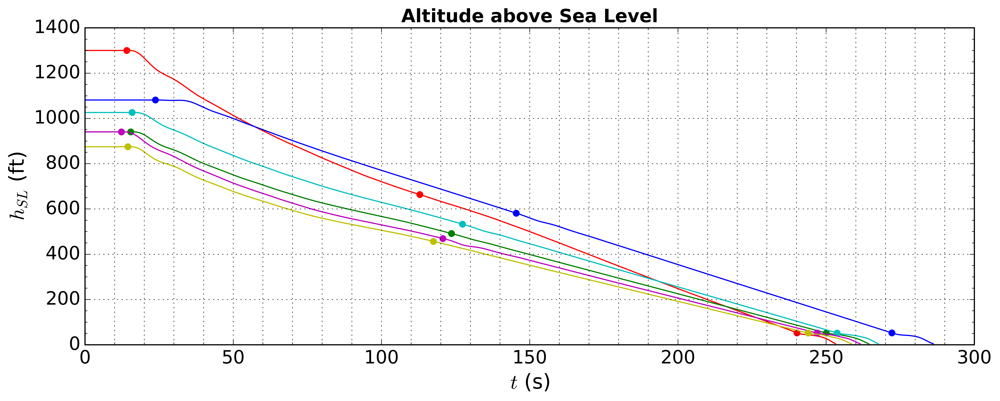

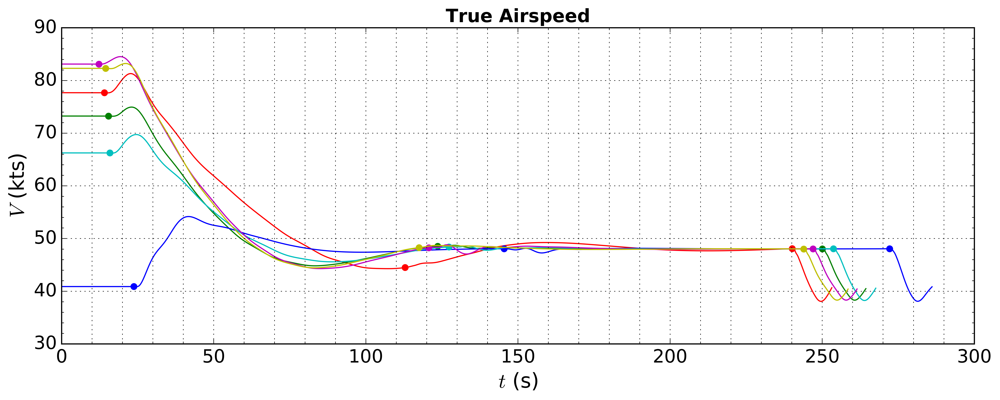

In [20]:
# Plot a series of variable time histories
GrA.plot_vars('h_sl_ft','V_kts')

Total time required: 0.66 s


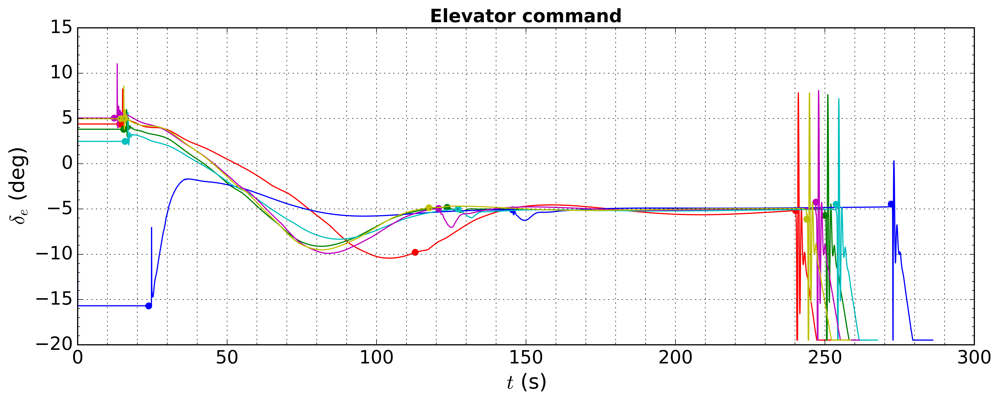

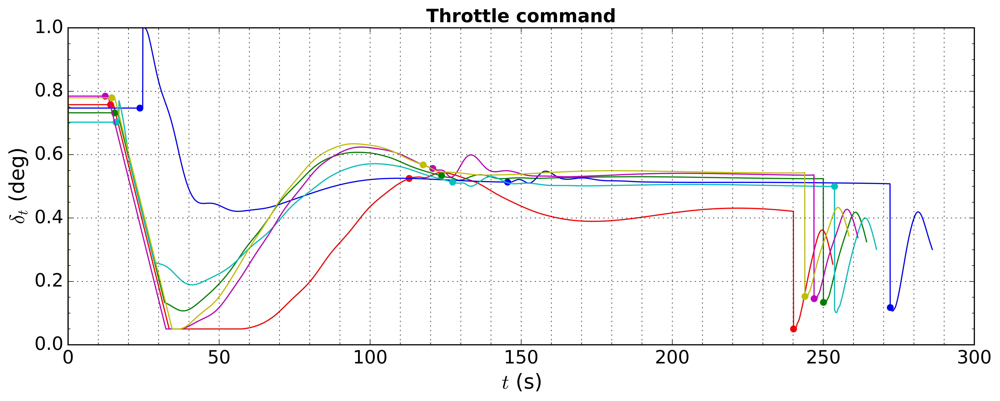

In [21]:
GrA.plot_vars('delta_e','delta_t')

Total time required: 1.16 s


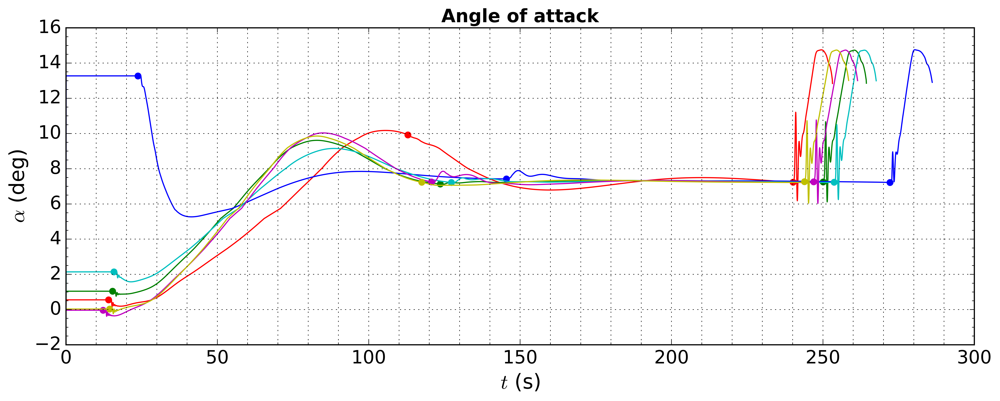

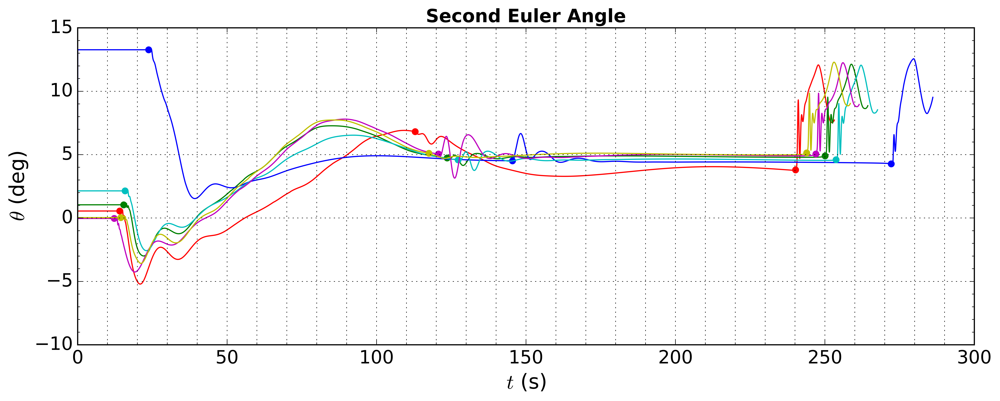

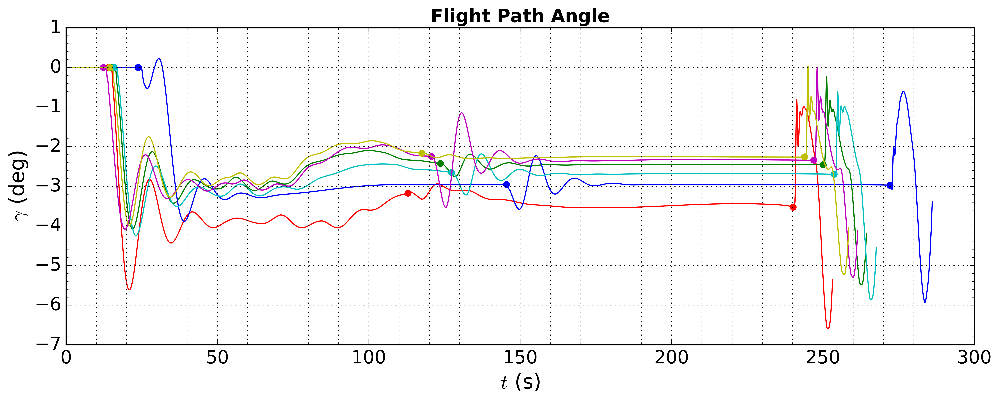

In [22]:
GrA.plot_vars('alpha_deg','theta_deg','gamma_deg')

Total time required: 0.97 s


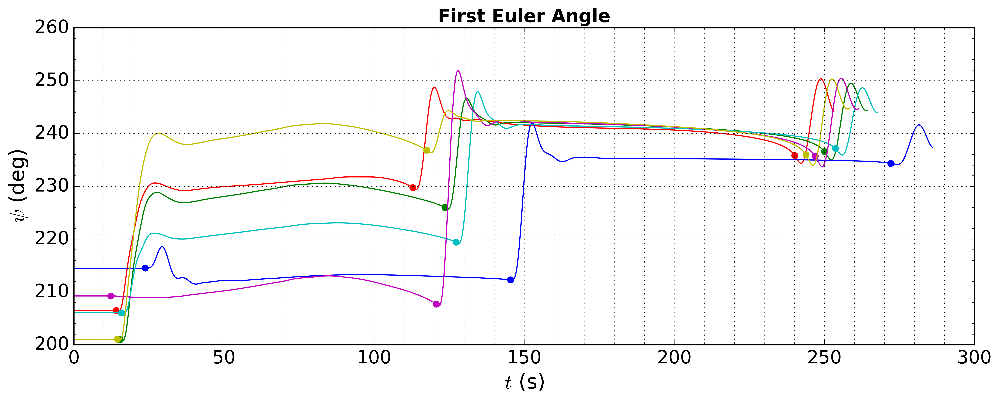

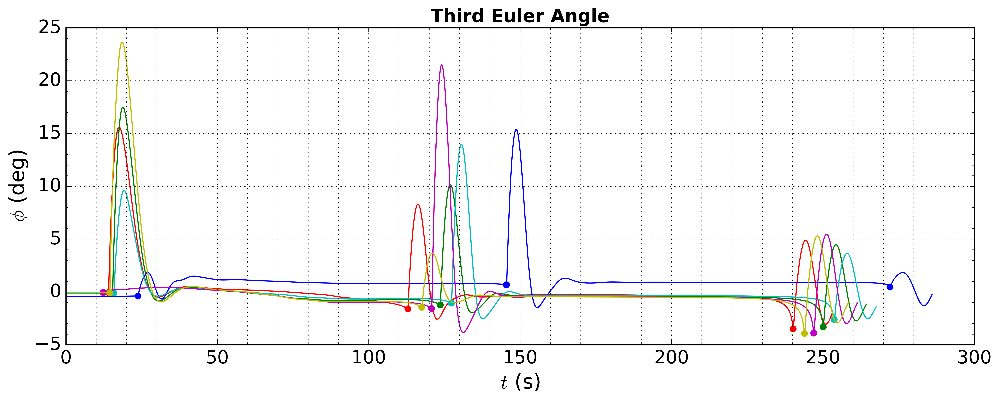

In [23]:
GrA.plot_vars('psi_deg','phi_deg')

In [24]:
# Plot ground track with waypoints
GrA.plot_ground_track([-2000, 20000, -2000, 20000])

Total time required: 0.29 s


Total time required: 1.13 s


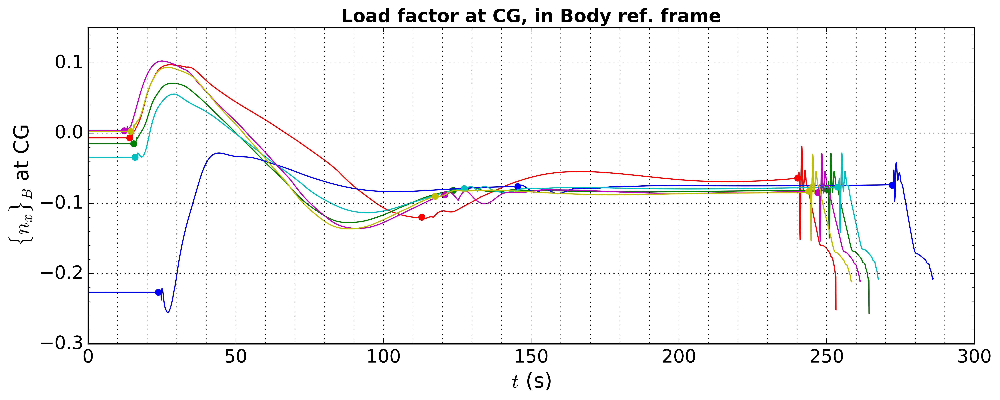

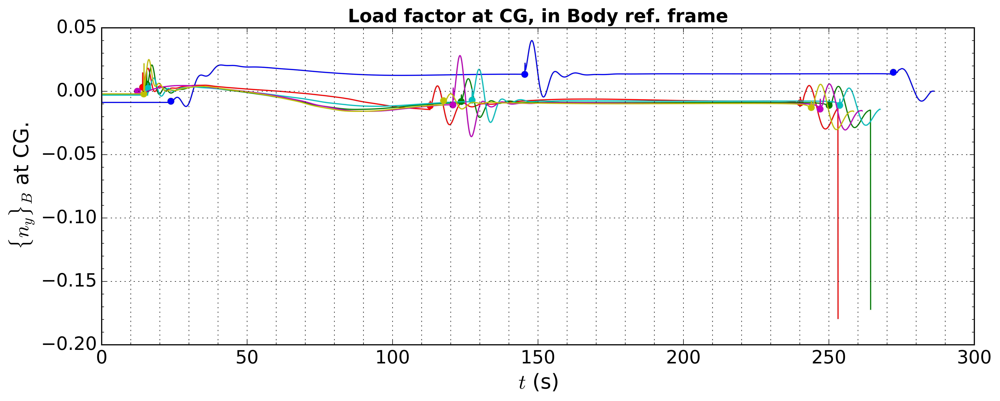

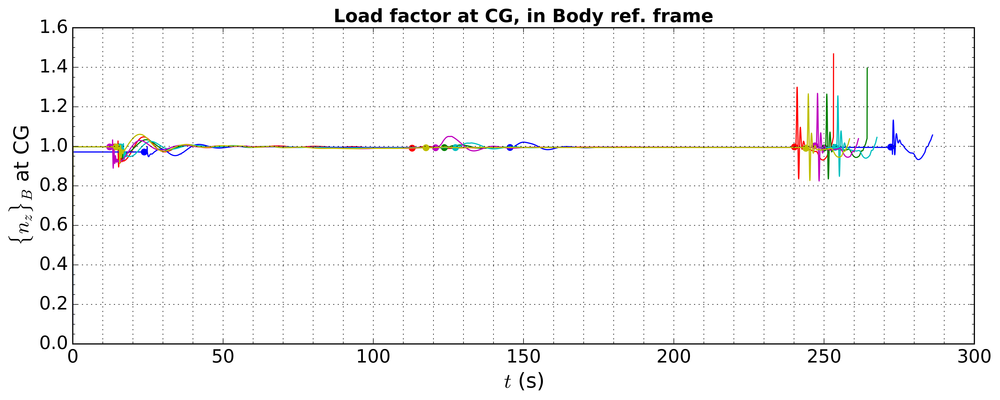

In [25]:
GrA.plot_vars('n_x','n_y','n_z')

### 4.1. Brute force plotting of the whole family of simulations

In [9]:
GrB = PostGroup(output_fol,'c172x_unina',range(1,51),'B')

Total time required: 211.23 s


In [10]:
GrB.load_traj_in_NEA()

Total time required: 4.17 s
Total time required: 2.07 s


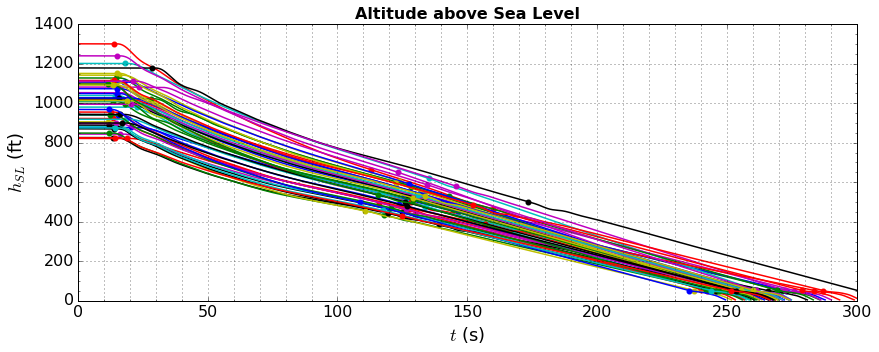

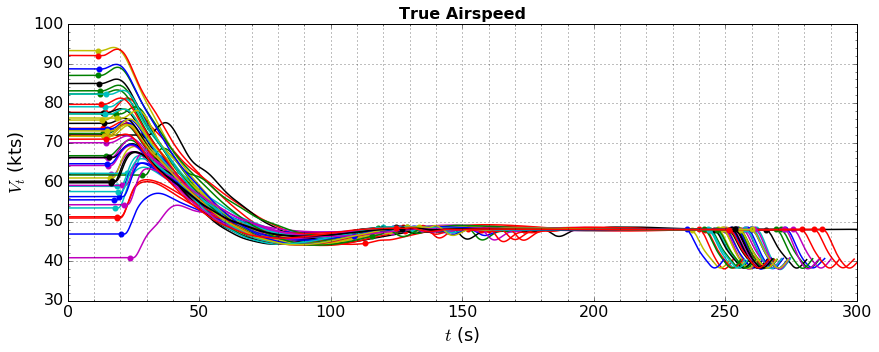

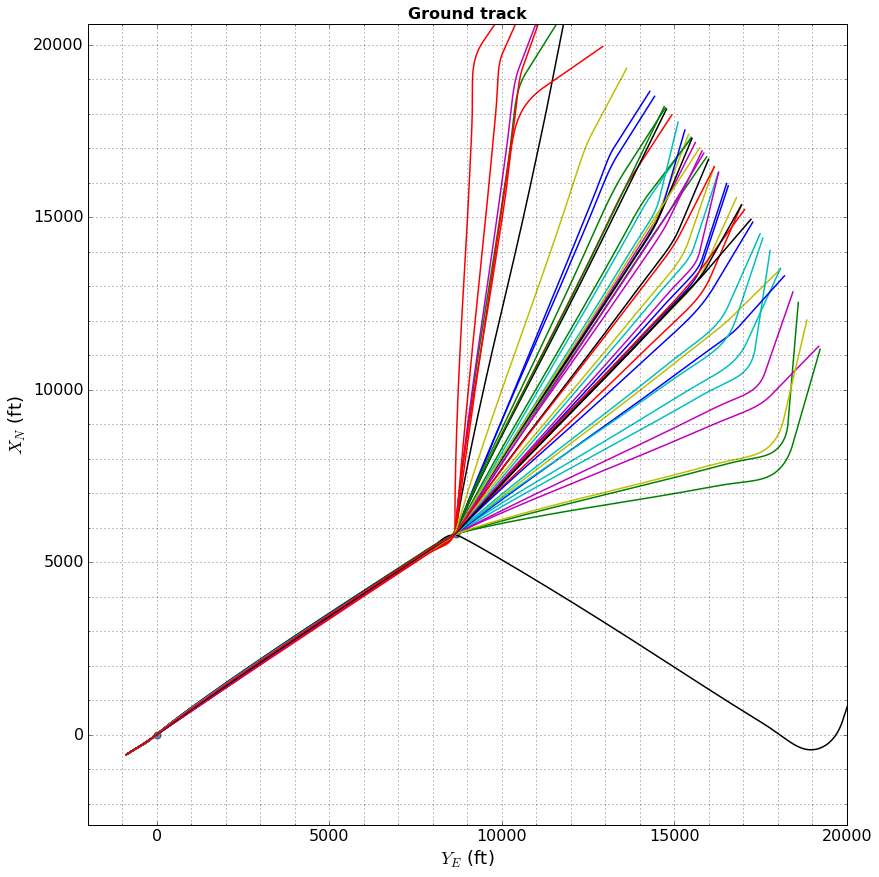

In [11]:
GrB.plot_vars('h_sl_ft','V_kts')
GrB.plot_ground_track([-2000, 20000, -2000, 20000])

In [ ]:
GrB.plot_vars('delta_e','delta_t')

Total time required: 1.87 s


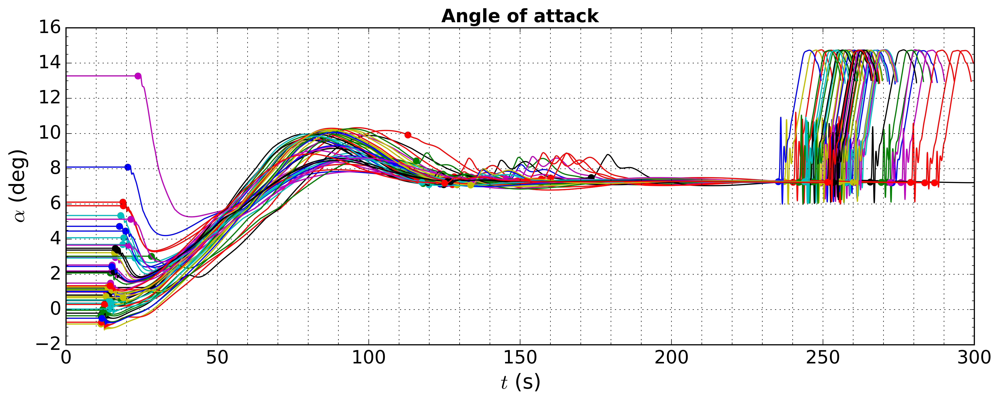

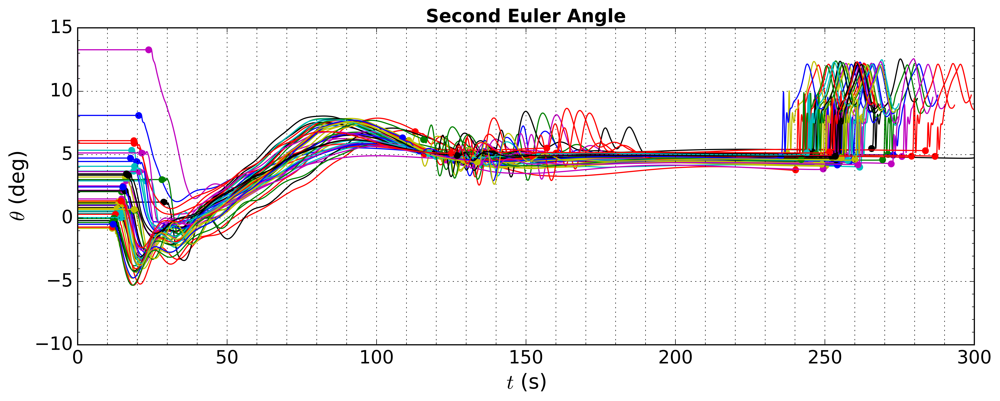

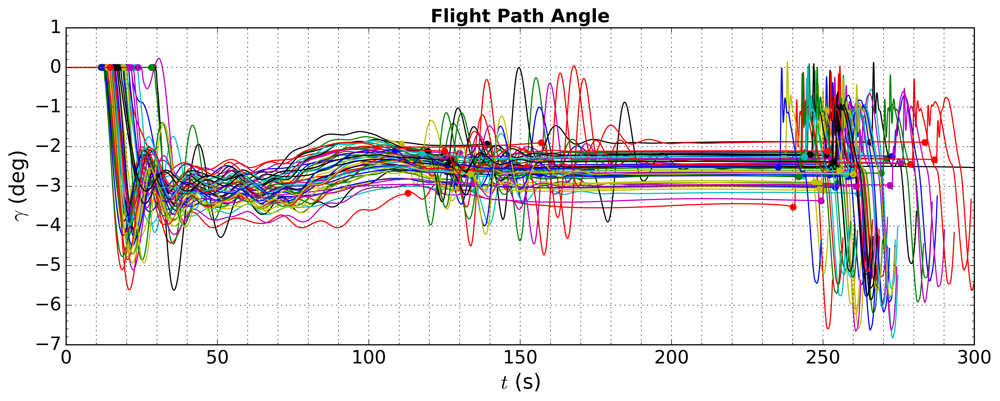

In [29]:
GrB.plot_vars('alpha_deg','theta_deg','gamma_deg')

Total time required: 0.99 s


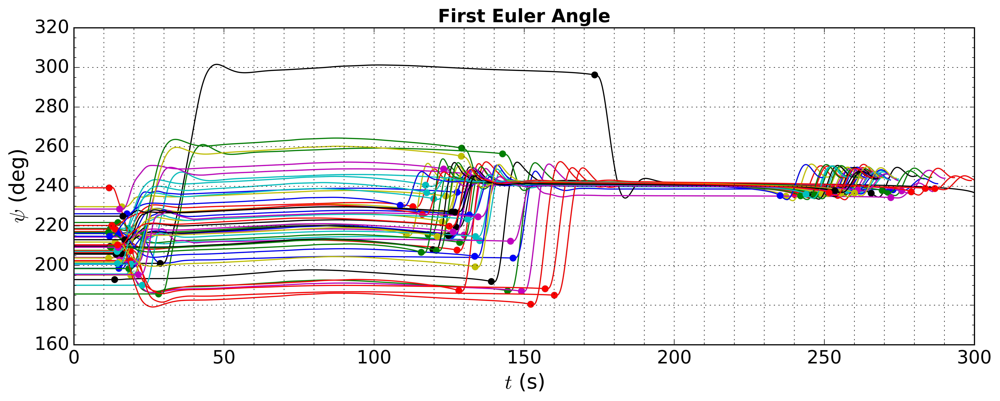

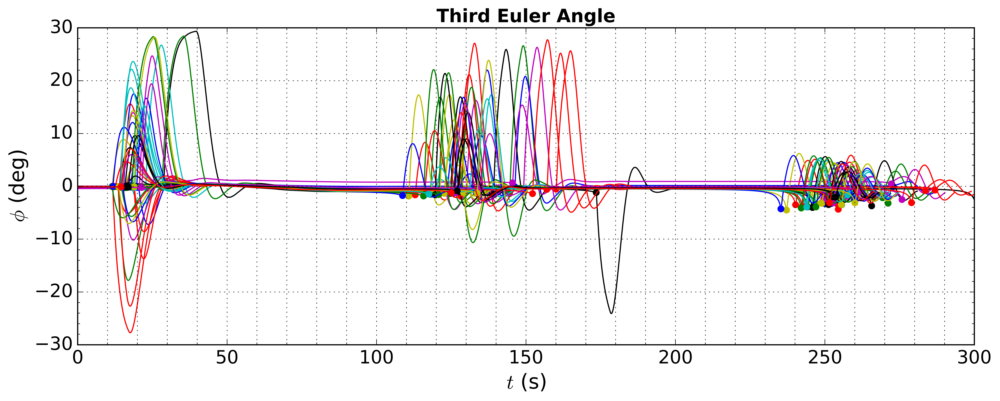

In [30]:
GrB.plot_vars('psi_deg','phi_deg')

Total time required: 1.37 s


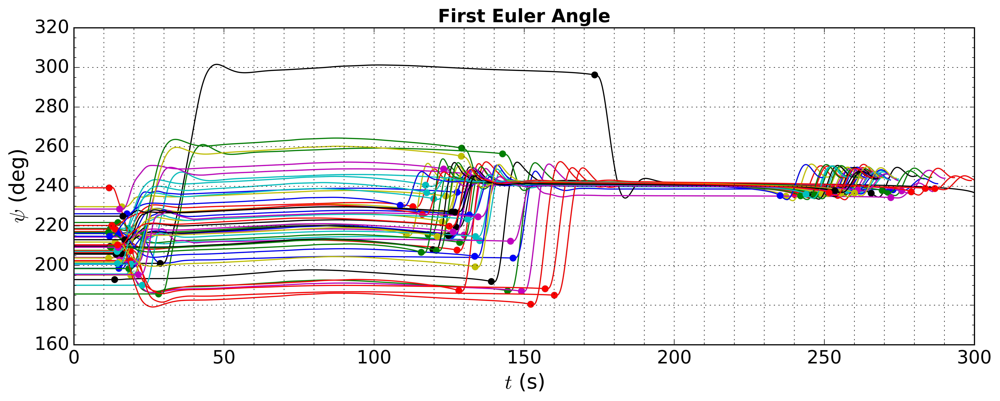

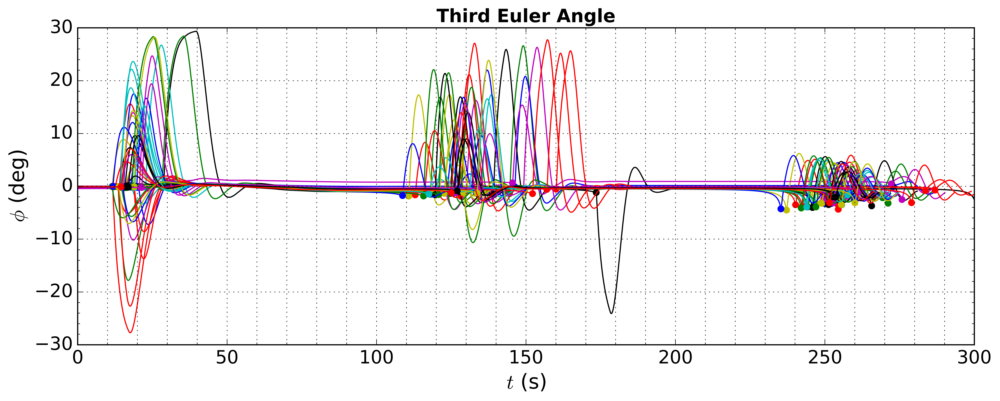

In [31]:
GrB.plot_vars('psi_deg','phi_deg')

### 4.2. Plotting versus trajectory length instead of time

Total time required: 1.34 s


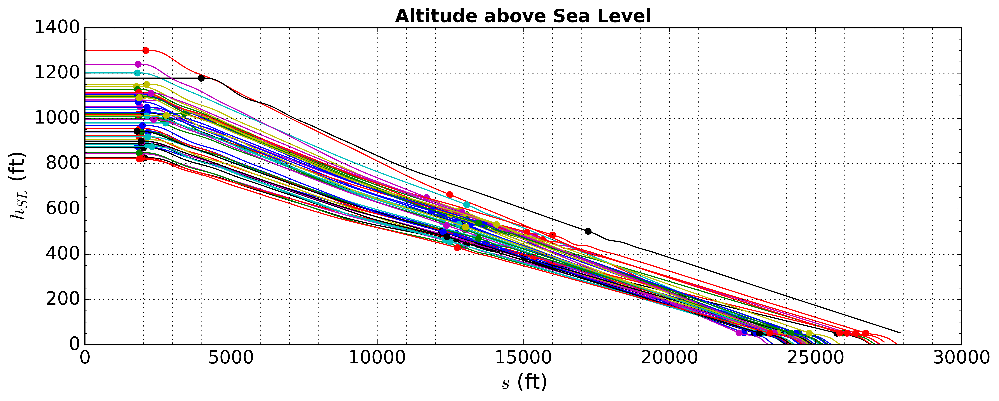

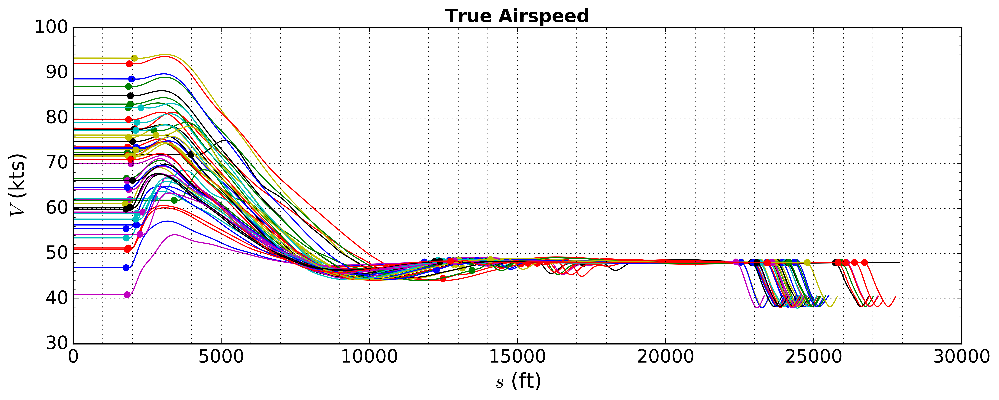

In [32]:
GrB.plot_vars_vs_s('h_sl_ft', 'V_kts')